# Predicting Conflict Types - NLP 

## Leveraging Data Science for ACLED(Armed Conflict Location & Event Data)

### Table of Contents

* [1. Introduction](#1.)
    * [1.1 What is ACLED?](#1.1)
    * [1.2 What is in ACLED?](#1.2)
    * [1.3 Hypothesis (What are we trying to predict?)](#1.3)
    * [1.4 Why are we Doing This?](#1.4)
* [2. Project Pipeline (DS Pipeline, Architecture Diagram)](#2)
* [3. Data Wrangling and Exploratory Data Analysis](#3)
    * [3.1 Exploratory Data Analysis](#3.1)
    * [3.1.1 Load in Dataset from CSV](#3.1.1)
    * [3.1.2 General Exploratory Analysis](#3.1.2)
    * [3.1.3 Event Type Analysis](#3.1.3)
* [4. Computation and Analysis](#4)
* [4.1 Text Pre-Processing](#4.1)
* [4.2 Word Cloud Analysis](#4.2)
* [5. Modeling and Application](#5)
    * [5.1 Model 1 - Classification Model](#5.1)
        * [5.1.1 Model 1 - Experimental Model with 2 Event Types](#5.1.1) 
        * [5.1.2 Model 1 - 6 Event Types](#5.1.2)
        * [5.1.3 Model 1 - 6 Event Types with Random Drop Sampling](#5.1.3)
* [6. Reporting and Visualizations](#6)
 

# 1. Introduction <a class="anchor" id="1.1"></a>

## 1.1 What is ACLED? <a class="anchor" id="1.1"></a>

<img src="https://github.com/georgetown-analytics/ACLED/blob/main/ACLED%20Pictures/ACLED%20Dashboard.PNG?raw=true" alt="acled landing">

The Armed Conflict Location & Event Data Project (ACLED) is a disaggregated data collection, analysis, and crisis mapping project. ACLED collects the dates, actors, locations, fatalities, and types of all reported political violence and protest events across Africa, the Middle East, Latin America & the Caribbean, East Asia, South Asia, Southeast Asia, Central Asia & the Caucasus, Europe, and the United States of America. 

The ACLED team conducts analysis to describe, explore, and test conflict scenarios, and makes both data and analysis open for free use by the public.

ACLED is a registered non-profit organization with 501(c)(3) status in the United States. ACLED receives financial support from the Bureau of Conflict and Stabilization Operations at the United States Department of State, the Dutch Ministry of Foreign Affairs, the German Federal Foreign Office, the Tableau Foundation, the International Organization for Migration, and The University of Texas at Austin.

## 1.2 What's in ACLED? <a class="anchor" id="1.2"></a>

<img src="https://github.com/georgetown-analytics/ACLED/blob/main/ACLED%20Pictures/whats%20in%20acled.PNG?raw=true" alt="what's in acled">

## 1.3 Hypothesis - What Are we Trying to Predict? <a class="anchor" id="1.3"></a>

* **Model 1** Event Type - Working within the framework of the data science pipeline our team utilized NLP against the notes (feature) section of the ACLED data to predict the event type of a particular demonstration in a region (multi classification and supervised).
* **Model 2** Sub-Event type - Topic Modeling -Using LDA to predict new sub-event types to increase new information for interventions
* **Model 3** Feeding new sub event types (model 2) back into the dataset, backfilling ACLED on new subevent types using Model 1
 <img src="https://github.com/georgetown-analytics/ACLED/blob/main/ACLED%20Pictures/event_type.PNG?raw=true" alt="event_type" width=420 height=380>

# 1.4 Why Are We Doing This? <a class="anchor" id="1.4"></a>

* Understanding Trends and creating new classifications increases the ability for agencies / governments to respond better to crisis by developing global strategies, influence current policies, and invest resources into new problem areas.
    * Improving accuracy in event types from ACLED researchers
    * Could we create sub-events that focuses on victims, i.e. gender based violence, violence against certain minorities/ protected classes? 
<img src="https://github.com/georgetown-analytics/ACLED/blob/main/ACLED%20Pictures/why%20are%20we%20doing%20this.PNG?raw=true" alt="why are we doing this" width=420 height=380>

# 2. Project Pipeline - Architecture Diagram <a class="anchor" id="2"></a>
<img src="https://github.com/georgetown-analytics/ACLED/blob/main/ACLED%20Pictures/ACLED%20design%20proposal.png?raw=true" alt="design proposal">

# 3.  Data Wrangling <a class="anchor" id="3"></a>

In this section, we explore the dataset for the first time, exploring basic questions about the data such as:

Understanding the Data
* What type of data is recorded?
* How large is the dataset?
* What data would be useful for the data model and experiment?
* Do we need to filter the data?

Data Integrity
* Are there any duplicates?
* Is there any null values?

## 3.1 Exploratory Data Analysis <a class="anchor" id="3.1"></a>

In [70]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
plt.rcParams["figure.dpi"] = 360
# displaying all columns and rows
pd.options.display.max_columns = None
pd.options.display.max_rows = None

### 3.1.1 Load in Dataset from CSV <a class="anchor" id="3.1.1"></a>

In [115]:
#load in csv from github repo
url = 'https://raw.githubusercontent.com/georgetown-analytics/ACLED/main/CSV_Main/2020-06-01-2021-06-01-Eastern_Africa-Middle_Africa-Northern_Africa-Southern_Africa-Western_Africa.csv'
df = pd.read_csv(url, index_col=0)

### 3.1.2 General Exploratory Analysis <a class="anchor" id="3.1.2"></a>

In [46]:
# look at first 5 rows of data
df.head()

,iso,event_id_cnty,event_id_no_cnty,event_date,year,time_precision,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,interaction,region,country,admin1,admin2,admin3,location,latitude,longitude,geo_precision,source,source_scale,notes,fatalities,timestamp,iso3
data_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
8166147,180,DRC21566,21566,01 June 2021,2021,1,Battles,Armed clash,ADF: Allied Democratic Forces,NaN,2,Military Forces of the Democratic Republic of ...,NaN,1,12,Middle Africa,Democratic Republic of Congo,Nord-Kivu,Beni,Oicha,Kokola,0.7821,29.6001,1,Al Nabaa,New media,"On 1 June 2021, the ADF attacked a military ba...",0,1624310472,COD
8166148,729,SUD15181,15181,01 June 2021,2021,1,Violence against civilians,Attack,Unidentified Armed Group (Sudan),NaN,3,Civilians (Sudan),NaN,7,37,Northern Africa,Sudan,Khartoum,Khartoum,NaN,Khartoum,15.5725,32.5364,1,Al Rakoba,National,"On 1 June 2021, three masked gunmen opened fir...",5,1624310472,SDN
8166410,426,LES165,165,01 June 2021,2021,1,Riots,Violent demonstration,Rioters (Lesotho),Labour Group (Lesotho),5,Police Forces of Lesotho (2017-),Civilians (Lesotho); Labour Group (Lesotho); C...,1,15,Southern Africa,Lesotho,Maseru,NaN,NaN,Maseru,-29.3167,27.4833,1,Post (Lesotho),National,"On 1 June 2021, workers pelted stones and loot...",0,1624310473,LSO
8166411,426,LES164,164,01 June 2021,2021,1,Riots,Violent demonstration,Rioters (Lesotho),Labour Group (Lesotho),5,Police Forces of Lesotho (2017-),NaN,1,15,Southern Africa,Lesotho,Leribe,NaN,NaN,Maputsoe,-28.8866,27.8991,1,Post (Lesotho),National,"On 1 June 2021, workers set tires on fire and ...",0,1624310473,LSO
8059405,800,UGA6836,6836,01 June 2021,2021,1,Violence against civilians,Attack,Unidentified Armed Group (Uganda),NaN,3,Civilians (Uganda),Government of Uganda (1986-); Former Military ...,7,37,Eastern Africa,Uganda,Central,Kampala,Kampala,Bukoto,0.3531,32.6000,1,Daily Monitor (Uganda); Chimp Reports,National,"On 1 June 2021, an unidentified armed group at...",2,1623100969,UGA


In [4]:
# see how many rows and columns are in this dataset
shape_info = df.shape 
print('This dataset contains {} rows  and {} columns' 
      .format(shape_info[0], 
              shape_info[1]))

This dataset contains 33378 rows  and 30 columns


In [5]:
# see list of all columns
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 33378 entries, 8166147 to 7518717
Data columns (total 30 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   iso               33378 non-null  int64  
 1   event_id_cnty     33378 non-null  object 
 2   event_id_no_cnty  33378 non-null  int64  
 3   event_date        33378 non-null  object 
 4   year              33378 non-null  int64  
 5   time_precision    33378 non-null  int64  
 6   event_type        33378 non-null  object 
 7   sub_event_type    33378 non-null  object 
 8   actor1            33378 non-null  object 
 9   assoc_actor_1     12763 non-null  object 
 10  inter1            33378 non-null  int64  
 11  actor2            21854 non-null  object 
 12  assoc_actor_2     8216 non-null   object 
 13  inter2            33378 non-null  int64  
 14  interaction       33378 non-null  int64  
 15  region            33378 non-null  object 
 16  country           33378 non-null

In [6]:
print(df.iloc[0:10]['notes'])

data_id
8166147    On 1 June 2021, the ADF attacked a military ba...
8166148    On 1 June 2021, three masked gunmen opened fir...
8166410    On 1 June 2021, workers pelted stones and loot...
8166411    On 1 June 2021, workers set tires on fire and ...
8059405    On 1 June 2021, an unidentified armed group at...
8059413    On 1 June 2021, doctors gathered at the Univer...
8059414    On 1 June 2021, several Zanu-PF youth marched ...
8059670    On 1 June 2021, a group set tire on fire, bloc...
8059671    On 1 June 2021, a group blocked the North and ...
8059418    On 1 June 2021, members of the National Union ...
Name: notes, dtype: object


In [7]:
example_notes = df.iloc[0]
print(example_notes['notes'])

On 1 June 2021, the ADF attacked a military base in the village of Kokola, located in the region of Beni (Nord-Kivu), leading soldiers to flee. No fatalities and/or injuries were reported. The ISCAP claimed the event.


In [8]:
#selecting columns that are pertient to the project
df_filter = df[['country', 'actor1', 'assoc_actor_1','event_type','sub_event_type', 'region', 'source','fatalities', 'latitude', 'longitude', 'notes']]

In [9]:
df_filter

,country,actor1,assoc_actor_1,event_type,sub_event_type,region,source,fatalities,latitude,longitude,notes
data_id,,,,,,,,,,,
8166147,Democratic Republic of Congo,ADF: Allied Democratic Forces,NaN,Battles,Armed clash,Middle Africa,Al Nabaa,0,0.7821,29.6001,"On 1 June 2021, the ADF attacked a military ba..."
8166148,Sudan,Unidentified Armed Group (Sudan),NaN,Violence against civilians,Attack,Northern Africa,Al Rakoba,5,15.5725,32.5364,"On 1 June 2021, three masked gunmen opened fir..."
8166410,Lesotho,Rioters (Lesotho),Labour Group (Lesotho),Riots,Violent demonstration,Southern Africa,Post (Lesotho),0,-29.3167,27.4833,"On 1 June 2021, workers pelted stones and loot..."
8166411,Lesotho,Rioters (Lesotho),Labour Group (Lesotho),Riots,Violent demonstration,Southern Africa,Post (Lesotho),0,-28.8866,27.8991,"On 1 June 2021, workers set tires on fire and ..."
8059405,Uganda,Unidentified Armed Group (Uganda),NaN,Violence against civilians,Attack,Eastern Africa,Daily Monitor (Uganda); Chimp Reports,2,0.3531,32.6000,"On 1 June 2021, an unidentified armed group at..."
8059413,Zambia,Protesters (Zambia),Health Workers (Zambia),Protests,Peaceful protest,Southern Africa,Mwebantu; Lusaka Times,0,-15.4166,28.2833,"On 1 June 2021, doctors gathered at the Univer..."
8059414,Zimbabwe,Rioters (Zimbabwe),ZANU-PF: Zimbabwe African National Union-Patri...,Riots,Violent demonstration,Southern Africa,263chat ZW; Manica Post; Bulawayo24,0,-18.9707,32.6709,"On 1 June 2021, several Zanu-PF youth marched ..."
8059670,South Africa,Rioters (South Africa),NaN,Riots,Violent demonstration,Southern Africa,Northern Natal News,0,-28.1668,30.2337,"On 1 June 2021, a group set tire on fire, bloc..."
8059671,South Africa,Protesters (South Africa),NaN,Protests,Peaceful protest,Southern Africa,Northern Natal News,0,-27.7688,30.8003,"On 1 June 2021, a group blocked the North and ..."


### 3.1.3 Event Type Analysis <a class="anchor" id="3.1.3"></a>

In [10]:
conflict_count = df_filter.groupby(['event_type','sub_event_type'])['sub_event_type'].count().to_frame()

In [11]:
conflict_count

sub_event_type
event_type                 sub_event_type                                     
Battles                    Armed clash                                    7040
                           Government regains territory                    308
                           Non-state actor overtakes territory             100
Explosions/Remote violence Air/drone strike                                404
                           Grenade                                         129
                           Remote explosive/landmine/IED                   769
                           Shelling/artillery/missile attack               215
                           Suicide bomb                                     26
Protests                   Excessive force against protesters              164
                           Peaceful protest                              10267
                           Protest with intervention                      1109
Riots                      Mob violence                                   1698
                           Violent demonstration                          2230
Strategic developments     Agreement                                        62
                           Arrests                                         137
                           Change to group/activity                         65
                           Disrupted weapons use                           113
                           Headquarters or base established                 33
                           Looting/property destruction                   1128
                           Non-violent transfer of territory                86
                           Other                                           154
Violence against civilians Abduction/forced disappearance                 1478
                           Attack                                         5472
                           Sexual violence                                 191

In [12]:
# event distribution by event_type and region

region_event_count=df_filter.pivot_table(index="region",
                 columns=["event_type"],
                 values="notes",
                 aggfunc="count",
                 margins=True)

region_event_count

event_type,Battles,Explosions/Remote violence,Protests,Riots,Strategic developments,Violence against civilians,All
region,,,,,,,
Eastern Africa,3124,631,764,628,376,2130,7653
Middle Africa,2115,94,863,635,784,2092,6583
Northern Africa,375,306,6478,679,100,423,8361
Southern Africa,8,1,1436,826,17,143,2431
Western Africa,1826,511,1999,1160,501,2353,8350
All,7448,1543,11540,3928,1778,7141,33378


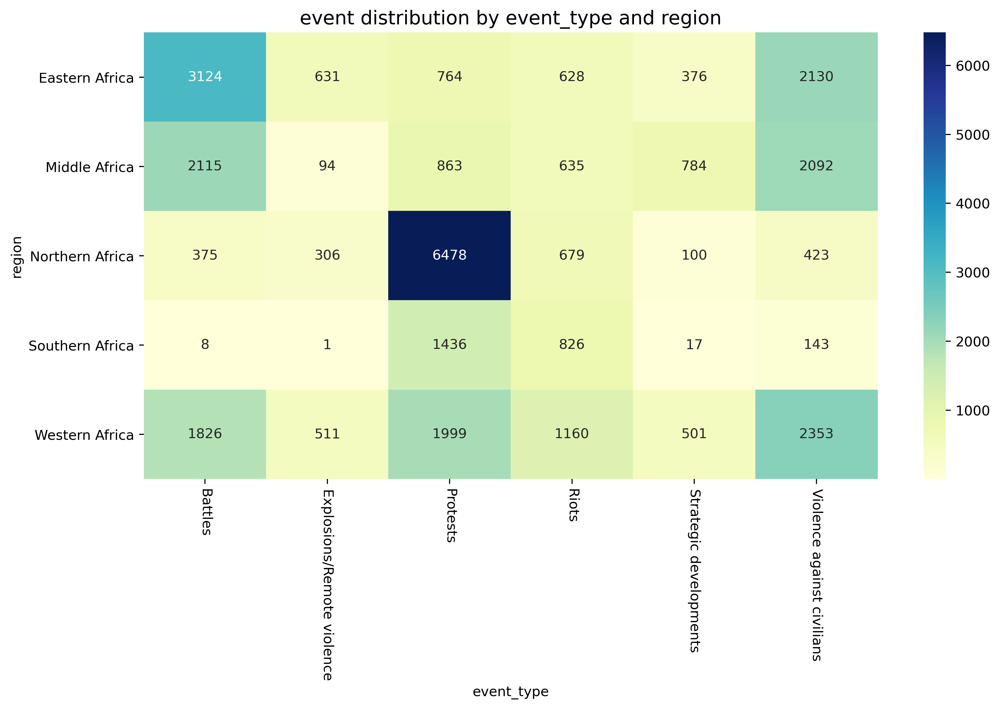

In [13]:
plt.figure(figsize=(12,6))

region_event_count2=df_filter.pivot_table(index="region",
                 columns=["event_type"],
                 values="notes",
                 aggfunc="count",
                 margins=False)

_=sns.heatmap(region_event_count2, 
            cmap="YlGnBu",
            annot=True,
              fmt='d')
_=plt.xticks(rotation=-90)
_=plt.title("event distribution by event_type and region",fontsize=14)

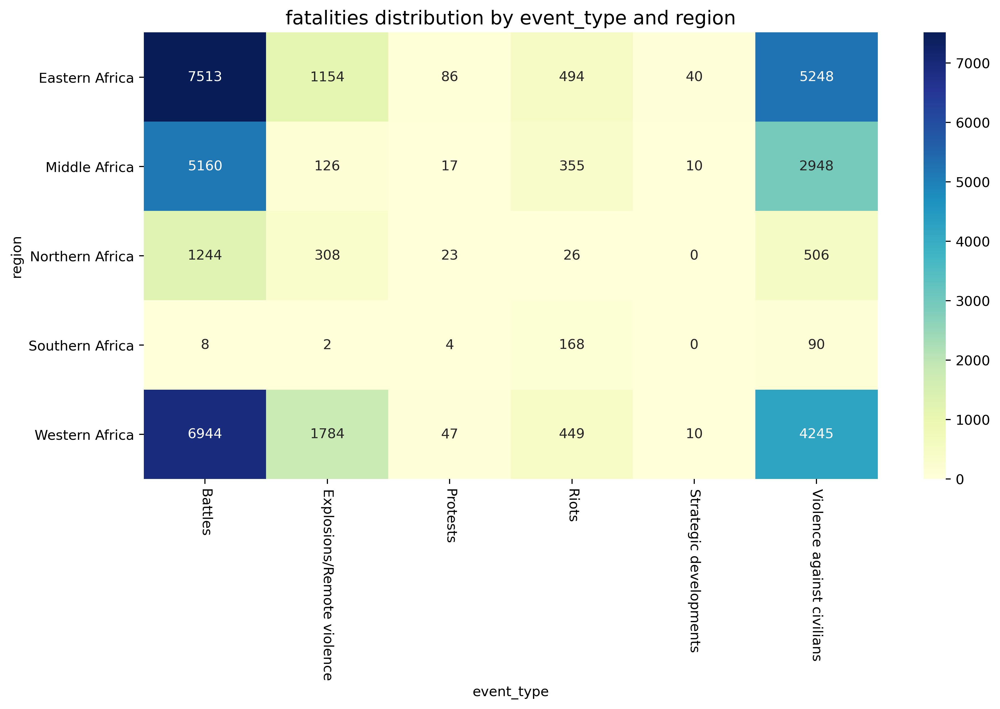

In [14]:

plt.figure(figsize=(12,6))

region_fatality_count2=df_filter.pivot_table(index="region",
                 columns=["event_type"],
                 values="fatalities",
                 aggfunc="sum",
                 margins=False)

_=sns.heatmap(region_fatality_count2, 
            cmap="YlGnBu",
            annot=True,
              fmt='d')
_=plt.xticks(rotation=-90)
_=plt.title("fatalities distribution by event_type and region",fontsize=14)

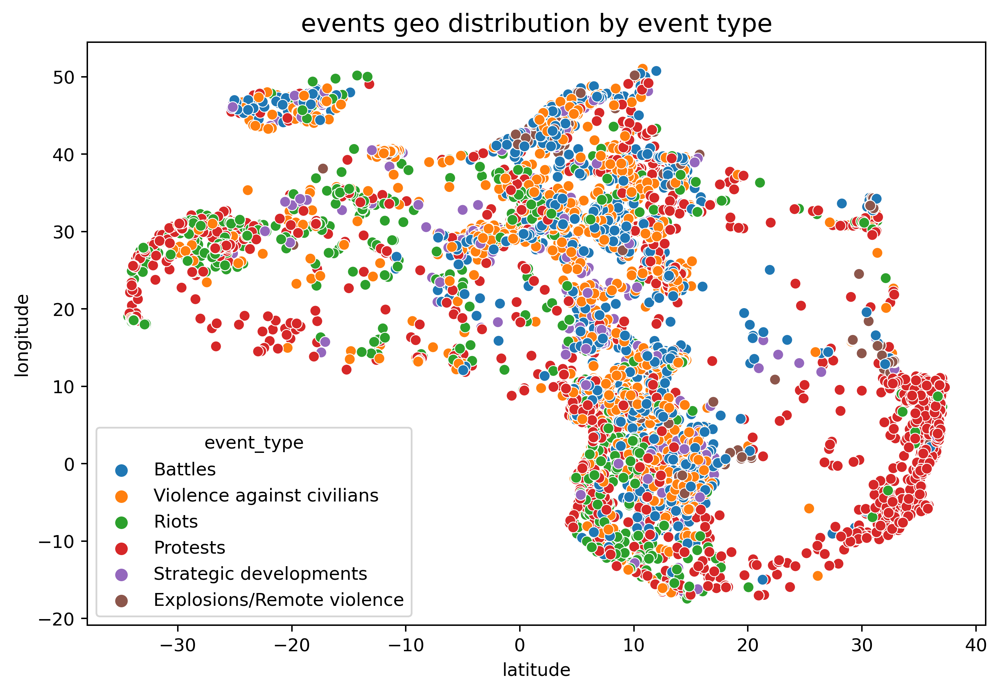

In [15]:
# event type distribution by geo

plt.figure(figsize=(9,6))
_=sns.scatterplot(x="latitude",
                  y="longitude",
                  hue="event_type",
                  data=df_filter)
_=plt.title("events geo distribution by event type",fontsize=14)

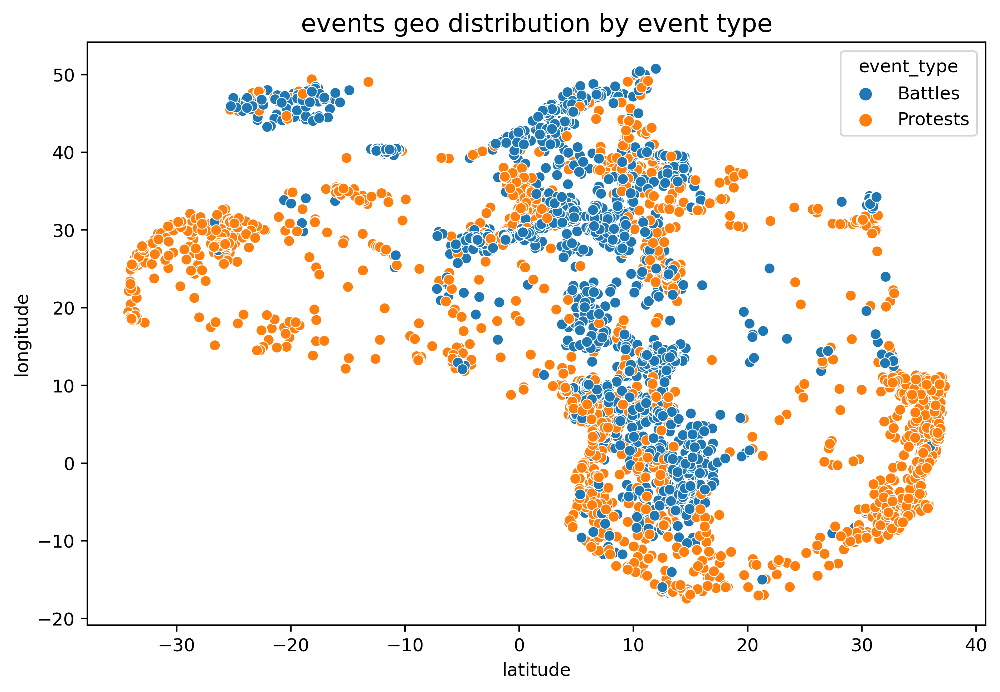

In [16]:
# if we only consider Protests and Battles type

plt.figure(figsize=(9,6))
_=sns.scatterplot(x="latitude",
                  y="longitude",
                  hue="event_type",
                  data=df_filter[df_filter["event_type"].isin(["Protests","Battles"])])
_=plt.title("events geo distribution by event type",fontsize=14)

# 4. Computation and Analysis <a class="anchor" id="4"></a>

## 4.1 Text Pre-Processing <a class="anchor" id="4.1"></a>

In this section, we will go through the common text pre-processing steps to prepare our data for Natural Language Processing (NLP) Modeling.

Common steps we took:
* Converting the text into lower case letters
* Removing numbers
* Removing stop words
    * stop words are words which are filtered out before or after processing of natural language data Though “stop words” usually refers to the most common words in a language, there is no single universal list of stop words used by all natural language processing tools.
* Lemmatization
    * Lemmatization is the process of grouping together the different inflected forms of a word so they can be analysed as a single item. Lemmatization is similar to stemming but it brings context to the words. So it links words with similar meaning to one word.
* Tokenization
    * Tokenization is about splitting strings of text into smaller pieces, or “tokens”. Paragraphs can be tokenized into sentences and sentences can be tokenized into words.
    
ACLED specific steps we took:
* Removing common ACLED words
* Removing months

In [116]:
import nltk
import re
from string import digits
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.stem import PorterStemmer
from nltk.tokenize import RegexpTokenizer
from nltk.stem import WordNetLemmatizer
ps = PorterStemmer()

In [117]:
#making all text in notes column lowercase
df["notes"]=df["notes"].str.lower()

In [118]:
# removing numbers
def remove_num(list):
    pattern = '[0-9]'
    list = [re.sub(pattern, '', i) for i in list]
    return list  
df["notes"] = remove_num(df["notes"])

In [119]:
lemmatizer = WordNetLemmatizer()

def word_lemmatizer(text):
    lem_text = [lemmatizer.lemmatize(i) for i in text]
    return lem_text
tokenizer = RegexpTokenizer(r'\w+')
df["notes"] = df["notes"].apply(lambda x: tokenizer.tokenize(x.lower()))

In [123]:
def remove_stopwords(text):
    words = [w for w in text if w not in stopwords.words('english')]
    return words
df["notes"] = df["notes"].apply(lambda x: remove_stopwords(x))

In [130]:
def common_acled_words(text):
    common_acled_words = ['report', 'size','january', 'feburary', 'march','april','may','june','july','august','september','october','november','december']
    words =[w for w in text if w not in common_acled_words]
    return words

In [133]:
df["notes"]

data_id
8166147    [adf, attacked, military, base, village, kokol...
8166148    [three, masked, gunmen, opened, fire, civilian...
8166410    [workers, pelted, stones, looted, shops, thets...
8166411    [workers, set, tires, fire, blocked, roads, ma...
8059405    [unidentified, armed, group, attacked, ministe...
8059413    [doctors, gathered, university, teaching, hosp...
8059414    [several, zanu, pf, youth, marched, mutare, mu...
8059670    [group, set, tire, fire, blocking, road, helpm...
8059671    [group, blocked, north, south, melmoth, roads,...
8059418    [members, national, union, unemployed, graduat...
8059426    [farmers, protested, beja, beja, nord, beja, d...
8059686    [unknown, gunmen, fired, upon, convoy, carryin...
8059690    [two, groups, government, police, forces, clas...
8059437    [dozens, aadl, social, housing, program, subsc...
8059444    [around, reported, private, sector, workers, h...
8059706    [imbonerakure, attacked, killed, cnl, member, ...
8059452    [grou

In [126]:
def common_protests_words(text):
    common_acled_words = ['protests', 'protest']
    words =[w for w in text if w not in common_acled_words]
    return words

In [127]:
#create sub dataframes for each event type
df_protests = df.loc[df['event_type'] == "Protests"]
df_riots = df.loc[df['event_type'] == "Riots"]
df_battles = df.loc[df['event_type'] == "Battles"]
df_violence_civilians = df.loc[df['event_type'] == "Violence against civilians"]
df_explosions = df.loc[df['event_type'] == "Explosions/Remote violence"]
df_development = df.loc[df['event_type'] == "Strategic developments"]

In [132]:
df["notes"] = df["notes"].apply(lambda x: common_acled_words(x))
df_protests["notes"] = df_protests["notes"].apply(lambda x: common_protests_words(x))

C:\Users\dhmph\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


## 4.2 Word Cloud Analysis <a class="anchor" id="4.2"></a>

* The number of events that occur in different regions can be calculated to determine which regions and which event types occur more frequently.Numerical visualization, the darker the color indicates the more times the event occurred.

* The following is the notes word cloud map for each event according to event type. The main purpose is to see the differences in the use of words in notes description under different event types, and what kind of words are used more in what events. If the classification model of Event type is to be made based on notes content, it is feasible to show the difference of notes description words in different event types first.
* From the word cloud map, we can see that there are clear differences in the use of different event types.


In [134]:
from wordcloud import WordCloud

In [157]:
df_filter=df[['event_type', 'notes']]

In [166]:
# generate notes text by event_type

event_type_notes=df_filter.dropna(subset=['notes']).groupby("event_type")["notes"].apply(list).to_dict()
print(event_type_notes.keys())

dict_keys(['Battles', 'Explosions/Remote violence', 'Protests', 'Riots', 'Strategic developments', 'Violence against civilians'])


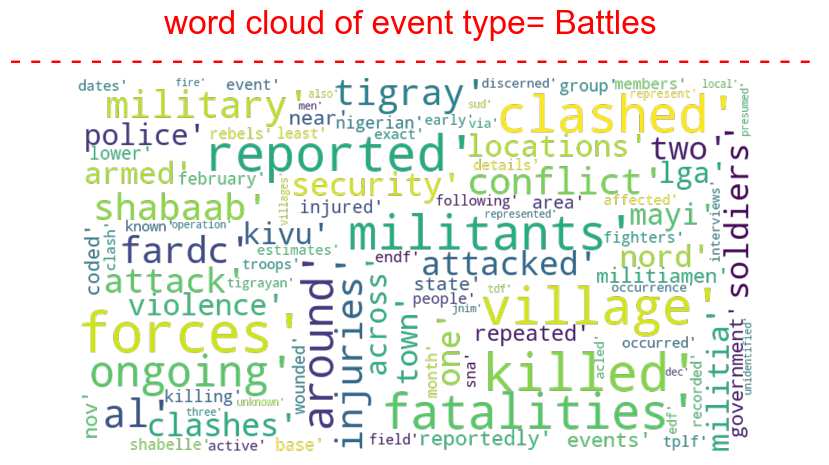

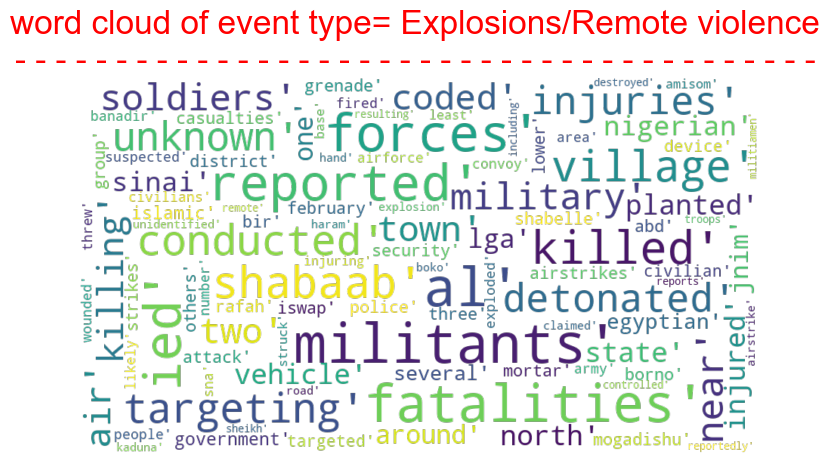

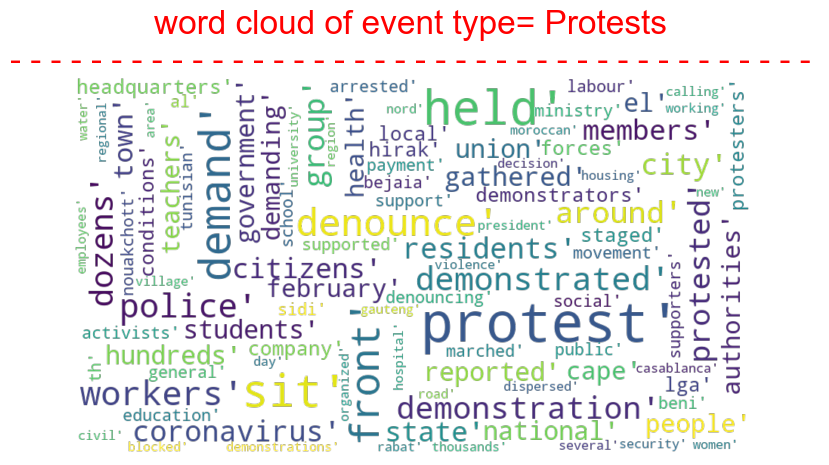

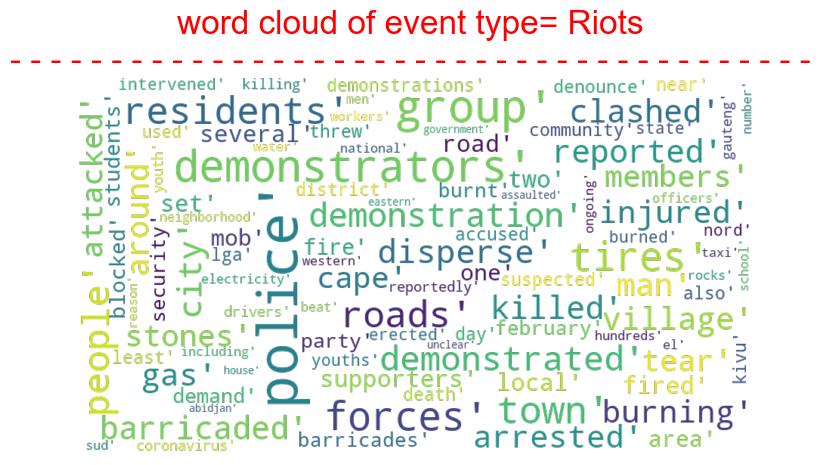

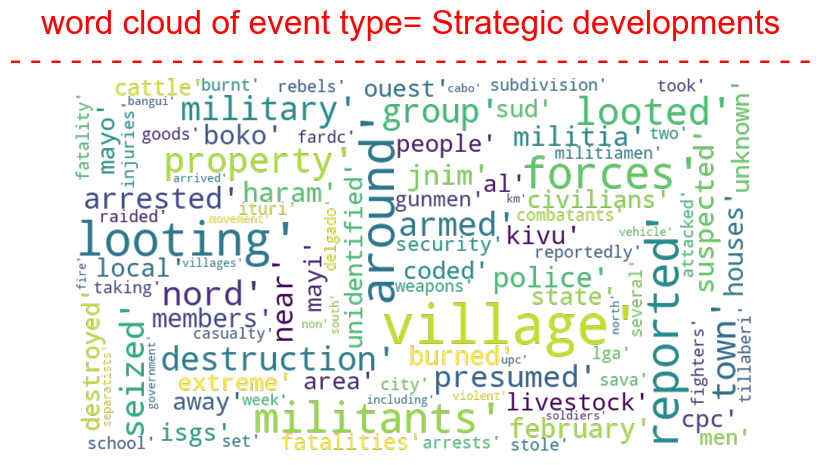

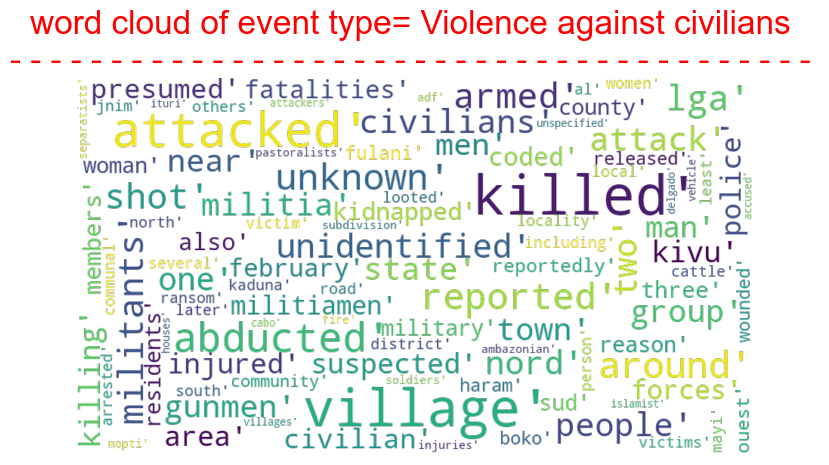

In [174]:

for k in event_type_notes.keys():
    
    text="".join(str(event_type_notes[k]))

    wc = WordCloud(width=900, height=500, 
                   mode='RGBA', background_color=None,
                   min_font_size=12,max_font_size=72,
                   collocations=False,prefer_horizontal=0.8,
                   max_words=100).generate(text)

    # show wordcloud img
    plt.figure(figsize=(9,5),dpi=100)
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.title("word cloud of event type= {} \n{}".format(k,'- '*40),fontsize=24,color='red')
    plt.show()
    print()

# 5. Modeling and Application <a class="anchor" id="5"></a>

Model 1: We are going to train a model that will predict the event type (target) of a particular event in a region (multi classification). This will be supervised learning as the input and output is already labelled. We are choosing the event type column to ensure that the model has no major errors in the data cleaning and wrangling process before continuing to more difficult models. Once we’ve established a working model, we would move to the next stage of the product.

Model 2 :We are going to train a model that will predict the sub-event type (target) of a particular event in a region (multi classification). Various features will be analyzed in an unsupervised fashion to identify any new clusters, and help determine the best predictor of the sub-event type. New features would include:
* Fatalities
* Region

Identifying new sub-event type clusters would increase the insights drawn from the notes and summary of each event. An example of this would identify gender based violence or violence against a minority class as a sub-event of Violence Against Civilians.

Types of Models
* Supervised Learning
    * Logistics Regression,
    * Random Forest 
    * Multinomial Naive Bayes, 

* Unsupervised Learning
    * Topic Modeling/LDA
    * K-Means

## 5.1 Model 1 - Classification Model <a class="anchor" id="5.1"></a>

The first model is an experimental model, testing the implementation of one model that we select, based on two kinds of events to reduce errors in testing and runtime.
* Protests
* Battles

### 5.1.1 Model 1 - Experimental Model with 2 Event Types <a class="anchor" id="5.1.1"></a>

In [215]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer

# from sklearn.naive_bayes import MultinomialNB
# from sklearn.linear_model import LogisticRegression
# from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,auc,accuracy_score,f1_score
from sklearn.model_selection import GridSearchCV

In [216]:
# Define two functions that will be used later in the drawing

def plotConfusionMaxtrix(confmat_data=None,xlabel='',ylabel='',title='',cmap=plt.cm.Blues,plt_ax=None):
    """
    Used for drawing - confusion matrix
    """
    plt_ax.matshow(confmat_data, cmap=cmap, alpha=0.75)
    for i in range(confmat_data.shape[0]):
        for j in range(confmat_data.shape[1]):
            plt_ax.text(x=j, y=i,s=confmat_data[i, j],va='center', ha='center',fontsize=12)
    plt_ax.set_xlabel(xlabel,fontsize=12)
    plt_ax.set_ylabel(ylabel,fontsize=12)
    plt_ax.set_title(title,fontsize=12)
    return 


def plotRocBinary(fpr=None,tpr=None,roc_auc=None,color='red',title='',plot_ax=None):
    plot_ax.plot(fpr, tpr, c=color,linewidth=2,label='ROC Curve (auc = %0.3f)' % roc_auc)
    plot_ax.plot([0, 1], [0, 1], 'k--',label='Random Prediction')
    plot_ax.set_xlim([0.0, 1.0])
    plot_ax.set_ylim([0.0, 1.0])
    plot_ax.set_xlabel('1 - Specifity',fontsize=12)
    plot_ax.set_ylabel('Sensitivity',fontsize=12)
    plot_ax.set_title(title,fontsize=12)
    for key in ["left","right","top","bottom"]:
        plot_ax.spines[key].set_alpha(0.3)
    plot_ax.legend(loc="lower right")
    return

In [219]:
# perpare x and y 
data_model=df[df["event_type"].isin(["Protests","Battles"])][["notes","event_type"]]
x=data_model["notes"]
y=data_model["event_type"].map({"Protests":0,"Battles":1})

# split train set and test set
xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.3,random_state=1)

In [220]:
# Extract text features using TFIDF

vectorizer = TfidfVectorizer(min_df=3,max_df=0.3)
xtrain_vectorizer=vectorizer.fit_transform(xtrain)
xtest_vectorizer =vectorizer.transform(xtest)

AttributeError: 'list' object has no attribute 'lower'

In [214]:
# Random forest was used as the classification model, and the super parameters were adjusted to make the model best

rf=RandomForestClassifier(random_state=42)

# set tune parameter
parameters = {'max_depth': range(3,51)}

grid_rf = GridSearchCV(rf, parameters,cv=5, n_jobs=-1)
grid_rf.fit(xtrain_vectorizer,ytrain)

# The optimal depth is 38
print("best_params: ",grid_rf.best_params_)

NameError: name 'xtrain_vectorizer' is not defined

In [180]:
# Look at the model's classification report on training data and test data

pred_ytrain_grid_rf=grid_rf.predict(xtrain_vectorizer)
pred_ytest_grid_rf=grid_rf.predict(xtest_vectorizer)

proba_ytrain_grid_rf=grid_rf.predict_proba(xtrain_vectorizer)
proba_ytest_grid_rf=grid_rf.predict_proba(xtest_vectorizer)

print("="*60)
print(" "*5,"Train Data Classification Report")
print(classification_report(ytrain,pred_ytrain_grid_rf))
print("="*60)

print(" "*5,"Test Data Classification Report")
print(classification_report(ytest,pred_ytest_grid_rf))
print("="*60)

NameError: name 'xtrain_vectorizer' is not defined

### 5.1.2 Model 1 - 6 Event Types <a class="anchor" id="5.1.2"></a>

In [181]:
# A function that defines the ROC of a multi-classification problem The ROC of multi-classification is not the same as the ROC of dichotomies

def plotRocMulti(fpr=None,tpr=None,roc_auc=None,title='',plot_ax=None):
    # plot Roc for each category
    colors=['peru','darkcyan','cyan','purple','red','blue']
    for i, color in zip(range(6), colors):
        plot_ax.plot(fpr[i], tpr[i], color=color, lw=2,label='ROC curve of Class:{0}(auc = {1:0.3f})'.format(i, roc_auc[i]))

    plot_ax.plot([0, 1], [0, 1], 'k--', lw=1)
    plot_ax.set_xlim([0.0, 1.0])
    plot_ax.set_ylim([0.0, 1.0])
    plot_ax.set_xlabel('1 - Specifity',fontsize=12)
    plot_ax.set_ylabel('Sensitivity',fontsize=12)
    plot_ax.set_title(title,fontsize=12)
    for key in ["left","right","top","bottom"]:
        plot_ax.spines[key].set_alpha(0.3)
    plot_ax.legend(loc="lower right")
    return

In [182]:
# Extract text features using TFIDF

vectorizer6 = TfidfVectorizer(min_df=3,max_df=0.3)
xtrain_vectorizer6=vectorizer6.fit_transform(xtrain)
xtest_vectorizer6 =vectorizer6.transform(xtest)

NameError: name 'xtrain' is not defined

In [183]:
# Random forest was used as the classification model, and the super parameters were adjusted to make the model best

rf=RandomForestClassifier(random_state=42)

# set tune parameter
parameters = {'max_depth': range(5,101,2)}

grid_rf6 = GridSearchCV(rf, parameters,cv=5, n_jobs=-1)
grid_rf6.fit(xtrain_vectorizer6,ytrain)

# The optimal depth is 97
print("best_params: ",grid_rf6.best_params_)

NameError: name 'xtrain_vectorizer6' is not defined

In [184]:
# perpare x and y 
data_model_6=data_sub[["notes_clean","event_type"]].copy()
x=data_model_6["notes_clean"]
y=data_model_6["event_type"].map({"Protests":0,
                                  "Battles":1,
                                  "Violence against civilians":2,
                                  "Riots":3,
                                  "Strategic developments":4,
                                  "Explosions/Remote violence":5})

# split train set and test set
xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.3,random_state=1)

NameError: name 'data_sub' is not defined

In [185]:
# Visualize the confusion matrix

confmat_train6 = confusion_matrix(y_true=ytrain, y_pred=pred_ytrain_grid_rf6)
confmat_test6 = confusion_matrix(y_true=ytest, y_pred=pred_ytest_grid_rf6)

# Plot Confusion Matrix
fig, (ax1, ax2) = plt.subplots(nrows=1,ncols=2,figsize=(16, 7))
#plot for train data
plotConfusionMaxtrix(confmat_data=confmat_train6,
                     xlabel='Predicted Label',
                     ylabel='True Label',
                     title='Train Data Confusion Matrix',
                     cmap=plt.cm.Blues,
                     plt_ax=ax1)
#plot for test data
plotConfusionMaxtrix(confmat_data=confmat_test6,
                     xlabel='Predicted Label',
                     ylabel='True Label',
                     title='Test Data Confusion Matrix',
                     cmap=plt.cm.Greens,
                     plt_ax=ax2)
plt.show()

NameError: name 'ytrain' is not defined

In [186]:
# Look at the model's classification report on training data and test data

pred_ytrain_grid_rf6=grid_rf6.predict(xtrain_vectorizer6)
pred_ytest_grid_rf6=grid_rf6.predict(xtest_vectorizer6)

print("="*60)
print(" "*5,"Train Data Classification Report")
print(classification_report(ytrain,pred_ytrain_grid_rf6))
print("="*60)

print(" "*5,"Test Data Classification Report")
print(classification_report(ytest,pred_ytest_grid_rf6))
print("="*60)

NameError: name 'xtrain_vectorizer6' is not defined

In [187]:
from sklearn.preprocessing import label_binarize

proba_ytrain_grid_rf6=grid_rf6.predict_proba(xtrain_vectorizer6)
proba_ytest_grid_rf6=grid_rf6.predict_proba(xtest_vectorizer6)

# Training data ROC
train_fpr = dict()
train_tpr = dict()
train_roc_auc = dict()
ytrain_bin = label_binarize(ytrain, classes=[0, 1, 2,3,4,5])
# Calculate the FPR TPR AUC for each category
for i in range(6):
    train_fpr[i], train_tpr[i], _ = roc_curve(ytrain_bin[:, i], proba_ytrain_grid_rf6[:, i])
    train_roc_auc[i] = auc(train_fpr[i], train_tpr[i])
    
# Test the ROC of data
test_fpr = dict()
test_tpr = dict()
test_roc_auc = dict()
ytest_bin = label_binarize(ytest, classes=[0, 1, 2,3,4,5])
# Calculate the FPR TPR AUC for each category
for i in range(6):
    test_fpr[i], test_tpr[i], _ = roc_curve(ytest_bin[:, i], proba_ytest_grid_rf6[:, i])
    test_roc_auc[i] = auc(test_fpr[i], test_tpr[i])
    
# draw
fig, (ax1, ax2) = plt.subplots(nrows=1,ncols=2,figsize=(16, 7))
plotRocMulti(fpr=train_fpr,tpr=train_tpr,roc_auc=train_roc_auc,title='ROC: Train Data',plot_ax=ax1)
plotRocMulti(fpr=test_fpr,tpr=test_tpr,roc_auc=test_roc_auc,title='ROC: Test Data',plot_ax=ax2)

NameError: name 'xtrain_vectorizer6' is not defined

### 5.1.3 Model 1 - 6 Event Types with Random Drop Sampling <a class="anchor" id="5.1.3"></a>

In [188]:
# imblearn Used to deal with unbalanced sample problems

from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

ModuleNotFoundError: No module named 'imblearn'

In [189]:
# Visualize the confusion matrix

confmat_train_pipe = confusion_matrix(y_true=ytrain, y_pred=pred_ytrain_grid_rf_pipe)
confmat_test_pipe = confusion_matrix(y_true=ytest, y_pred=pred_ytest_grid_rf_pipe)

# Plot Confusion Matrix
fig, (ax1, ax2) = plt.subplots(nrows=1,ncols=2,figsize=(16, 7))
#plot for train data
plotConfusionMaxtrix(confmat_data=confmat_train_pipe,
                     xlabel='Predicted Label',
                     ylabel='True Label',
                     title='Train Data Confusion Matrix',
                     cmap=plt.cm.Blues,
                     plt_ax=ax1)
#plot for test data
plotConfusionMaxtrix(confmat_data=confmat_test_pipe,
                     xlabel='Predicted Label',
                     ylabel='True Label',
                     title='Test Data Confusion Matrix',
                     cmap=plt.cm.Greens,
                     plt_ax=ax2)
plt.show()

NameError: name 'ytrain' is not defined

In [190]:
# Look at the model's classification report on training data and test data

pred_ytrain_grid_rf_pipe=grid_rf_pipe.predict(xtrain_vectorizer6)
pred_ytest_grid_rf_pipe=grid_rf_pipe.predict(xtest_vectorizer6)

proba_ytrain_grid_rf_pipe=grid_rf_pipe.predict_proba(xtrain_vectorizer6)
proba_ytest_grid_rf_pipe=grid_rf_pipe.predict_proba(xtest_vectorizer6)

print("="*60)
print(" "*5,"Train Data Classification Report")
print(classification_report(ytrain,pred_ytrain_grid_rf_pipe))
print("="*60)

print(" "*5,"Test Data Classification Report")
print(classification_report(ytest,pred_ytest_grid_rf_pipe))
print("="*60)

NameError: name 'grid_rf_pipe' is not defined

In [191]:

# A balanced sample training model is constructed by random falling sampling

# The first step in building a pipeline is to do random drop sampling and the second step is classifier
rf_pipe = Pipeline(
    [
        ('sampling', RandomUnderSampler(random_state=42)),
        ('classifier', RandomForestClassifier(random_state=42))   
    ])

# search for best parameters by GridSearchCV
parameters = {'classifier__max_depth': range(5,101,2)}

grid_rf_pipe = GridSearchCV(rf_pipe, parameters,cv=5,n_jobs=-1)
grid_rf_pipe.fit(xtrain_vectorizer6,ytrain)

# The optimal depth is 95
print("best_params: ",grid_rf_pipe.best_params_)

NameError: name 'RandomUnderSampler' is not defined

In [192]:
# Predict the probability of each class of events
proba_ytrain_grid_rf_pipe=grid_rf_pipe.predict_proba(xtrain_vectorizer6)
proba_ytest_grid_rf_pipe=grid_rf_pipe.predict_proba(xtest_vectorizer6)

# Training data ROC
train_fpr = dict()
train_tpr = dict()
train_roc_auc = dict()
ytrain_bin = label_binarize(ytrain, classes=[0, 1, 2,3,4,5])
# Calculate the FPR TPR AUC for each category
for i in range(6):
    train_fpr[i], train_tpr[i], _ = roc_curve(ytrain_bin[:, i], proba_ytrain_grid_rf_pipe[:, i])
    train_roc_auc[i] = auc(train_fpr[i], train_tpr[i])
    
# Test the ROC of data
test_fpr = dict()
test_tpr = dict()
test_roc_auc = dict()
ytest_bin = label_binarize(ytest, classes=[0, 1, 2,3,4,5])
# Calculate the FPR TPR AUC for each category
for i in range(6):
    test_fpr[i], test_tpr[i], _ = roc_curve(ytest_bin[:, i], proba_ytest_grid_rf_pipe[:, i])
    test_roc_auc[i] = auc(test_fpr[i], test_tpr[i])
    
# draw
fig, (ax1, ax2) = plt.subplots(nrows=1,ncols=2,figsize=(16, 7))
plotRocMulti(fpr=train_fpr,tpr=train_tpr,roc_auc=train_roc_auc,title='ROC: Train Data',plot_ax=ax1)
plotRocMulti(fpr=test_fpr,tpr=test_tpr,roc_auc=test_roc_auc,title='ROC: Test Data',plot_ax=ax2)

NameError: name 'grid_rf_pipe' is not defined

### 5.1.4 Model 1 - Multiple Model Selection Testing

In [193]:
from yellowbrick.classifier import ClassificationReport
from yellowbrick.classifier import ClassPredictionError

from sklearn.pipeline import Pipeline


from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score, recall_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestRegressor

from sklearn.naive_bayes import MultinomialNB

In [194]:
X = df["notes"].values
y_raw = df["event_type"].values

# encoding our labels
encoder = LabelEncoder()
encoder.fit(y_raw)
y = encoder.transform(y_raw)
# if we want to go backwards and interpret what the numeric labels mean:
print(encoder.inverse_transform([0, 0, 1, 2]))

['Battles' 'Battles' 'Explosions/Remote violence' 'Protests']


In [195]:
vectorizers = [CountVectorizer(), TfidfVectorizer()]
algorithms = [RandomForestClassifier(), LogisticRegression(), MultinomialNB()] # add Naive Bayes Classifier also

In [196]:
def score_model(X, y, algorithm, vectorizer):
    """
    Test various estimators.
    """
    model = Pipeline([
        ('vectorizer', vectorizer),
        ('estimator', algorithm)
    ])

    # split the data
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.33, random_state=42
    )
    
    # Instantiate the classification model and visualizer
    model.fit(X_train, y_train)

    expected  = y_test
    predicted = model.predict(X_test)

    # Compute and return F1 (harmonic mean of precision and recall)
    print("{}: {}".format(algorithm.__class__.__name__, f1_score(expected, predicted, average='micro')))

In [197]:
for algorithm in algorithms:
    for vectorizer in vectorizers:
        score_model(X, y, algorithm, vectorizer)

AttributeError: 'list' object has no attribute 'lower'

In [198]:
def visualize_model(X, y, algorithm, vectorizer):
    """
    Visually compare the models
    """
    model = Pipeline([
        ('vectorizer', vectorizer),
        ('estimator', algorithm)
    ])

    # Instantiate the classification model and visualizer
    visualizer = ClassificationReport(
        model, classes=encoder.classes_
    )
    
    # split the data
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.33, random_state=42
    )
    
    visualizer.fit(X_train, y_train)
    visualizer.score(X_test, y_test)
    visualizer.show()

In [199]:
for algorithm in algorithms:
    for vectorizer in vectorizers:
        visualize_model(X, y, algorithm, vectorizer)

AttributeError: 'list' object has no attribute 'lower'

In [200]:
# Create class prediction error function

def evaluate_model(X, y, algorithm, vectorizer):
    """
    Evaluate various estimators.
    """
    model = Pipeline([
        ('vectorizer', vectorizer),
        ('estimator', algorithm)
    ])

  
    # split the data
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.33, random_state=42
    )
    
# Instantiate the class prediction error and visualizer
    visualizer = ClassPredictionError(
        model, classes=encoder.classes_
    )

# Fit the training data to the visualizer
    visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
    visualizer.score(X_test, y_test)

# Draw visualization
    visualizer.show()

In [201]:
for algorithm in algorithms:
    for vectorizer in vectorizers:
        evaluate_model(X, y, algorithm, vectorizer)

AttributeError: 'list' object has no attribute 'lower'

## 5.2 Topic Modeling - LDA <a class="anchor" id="5.2"></a>

In [202]:
import gensim
from gensim.utils import simple_preprocess
import gensim.corpora as corpora
from pprint import pprint

C:\Users\dhmph\AppData\Roaming\Python\Python37\site-packages\gensim\similarities\__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


In [203]:
#convert sub-dataframes to lists for topic modeling
data_words_protests = list(df_protests['notes'])
data_words_riots = list(df_riots['notes']) 
data_words_battles = list(df_battles['notes'])
data_words_violence_civilians = list(df_violence_civilians['notes'])
data_words_explosions = list(df_explosions['notes'])
data_words_development = list(df_development['notes'])

In [204]:
data_words = list(df['notes'])
# Create Dictionary
id2word = corpora.Dictionary(data_words)
# Create Corpus
texts = data_words
# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]
# LDA model training
# number of topics
num_topics = 10
# Build LDA model
lda_model = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)
# Print the Keyword in the 10 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.012*"group" + 0.011*"killed" + 0.008*"armed" + 0.007*"people" + '
  '0.007*"mayi" + 0.007*"near" + 0.006*"village" + 0.006*"police" + '
  '0.006*"demand" + 0.006*"front"'),
 (1,
  '0.014*"town" + 0.014*"police" + 0.009*"cape" + 0.009*"killed" + '
  '0.007*"members" + 0.007*"protest" + 0.007*"reported" + 0.006*"demand" + '
  '0.006*"group" + 0.006*"village"'),
 (2,
  '0.018*"village" + 0.015*"reported" + 0.011*"fatalities" + 0.010*"forces" + '
  '0.010*"killed" + 0.009*"attacked" + 0.009*"people" + 0.009*"state" + '
  '0.009*"around" + 0.009*"militants"'),
 (3,
  '0.015*"village" + 0.014*"militants" + 0.013*"forces" + 0.011*"al" + '
  '0.010*"shabaab" + 0.009*"ongoing" + 0.008*"protest" + 0.007*"around" + '
  '0.007*"reported" + 0.007*"attacked"'),
 (4,
  '0.014*"village" + 0.012*"forces" + 0.011*"killed" + 0.011*"protest" + '
  '0.009*"militants" + 0.009*"two" + 0.008*"held" + 0.008*"group" + '
  '0.008*"sit" + 0.008*"al"'),
 (5,
  '0.011*"forces" + 0.011*"village" + 0.010*"k

### Load in Topic Modeling visualization

In [205]:
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
# Visualize the topics
pyLDAvis.enable_notebook()

In [206]:
vis = pyLDAvis.gensim_models.prepare(lda_model, corpus, id2word)

C:\Users\dhmph\AppData\Roaming\Python\Python37\site-packages\pyLDAvis\_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


In [207]:
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2      0.059800 -0.056859       1        1  14.404481
4      0.021990 -0.019158       2        1  12.678638
1      0.040529  0.042409       3        1  10.916037
6      0.039074 -0.002235       4        1  10.680657
5      0.035217  0.037835       5        1  10.541894
0      0.038527  0.026337       6        1   9.391254
9      0.034417  0.007144       7        1   8.987615
8     -0.009920  0.005046       8        1   8.291638
3     -0.063636 -0.062666       9        1   7.849275
7     -0.195998  0.022147      10        1   6.258513, topic_info=                 Term         Freq        Total Category  logprob  loglift
1168          ongoing  2266.000000  2266.000000  Default  30.0000  30.0000
2324         conflict  1566.000000  1566.000000  Default  29.0000  29.0000
2541           tigray  1567.000000  1567.000000  Default  28.0000  28.0000
5371         repeated   975.000000   975.000000  Default  27.0000  27.0000
517         locations  1120.000000  1120.000000  Default  26.0000  26.0000
12880             nov   898.000000   898.000000  Default  25.0000  25.0000
1592         violence  1502.000000  1502.000000  Default  24.0000  24.0000
21             around  5885.000000  5885.000000  Default  23.0000  23.0000
12882       represent   481.000000   481.000000  Default  22.0000  22.0000
12876             edf   481.000000   481.000000  Default  21.0000  21.0000
8393         tigrayan   491.000000   491.000000  Default  20.0000  20.0000
12884             tdf   479.000000   479.000000  Default  19.0000  19.0000
12875       discerned   480.000000   480.000000  Default  18.0000  18.0000
12878      interviews   485.000000   485.000000  Default  17.0000  17.0000
8007         affected   506.000000   506.000000  Default  16.0000  16.0000
12881      occurrence   481.000000   481.000000  Default  15.0000  15.0000
513              endf   598.000000   598.000000  Default  14.0000  14.0000
12874           dates   491.000000   491.000000  Default  13.0000  13.0000
12877       estimates   485.000000   485.000000  Default  12.0000  12.0000
12872           acled   482.000000   482.000000  Default  11.0000  11.0000
3110            early   508.000000   508.000000  Default  10.0000  10.0000
1902         recorded   507.000000   507.000000  Default   9.0000   9.0000
12883     represented   486.000000   486.000000  Default   8.0000   8.0000
12475             via   491.000000   491.000000  Default   7.0000   7.0000
7073           active   527.000000   527.000000  Default   6.0000   6.0000
3862            exact   499.000000   499.000000  Default   5.0000   5.0000
253           shabaab  1987.000000  1987.000000  Default   4.0000   4.0000
8514            field   566.000000   566.000000  Default   3.0000   3.0000
19962             dec   420.000000   420.000000  Default   2.0000   2.0000
2140         occurred   601.000000   601.000000  Default   1.0000   1.0000
13585           darey    18.806650    19.656154   Topic1  -8.6394   1.8935
13586           tinni    18.790082    19.639593   Topic1  -8.6402   1.8934
20885         machava     7.585151     8.437266   Topic1  -9.5474   1.8312
7047            hosna     9.135268    10.485015   Topic1  -9.3614   1.7998
30866        entrench    28.388051    32.743491   Topic1  -8.2276   1.7949
20866          bopolu     5.094952     5.944436   Topic1  -9.9453   1.7834
8037      chinagodrar    11.304779    13.262854   Topic1  -9.1483   1.7779
22436          pacify     5.000554     5.923000   Topic1  -9.9640   1.7683
20439            urur     4.487775     5.406897   Topic1 -10.0722   1.7513
1752            rafah   195.843692   236.371255   Topic1  -6.2963   1.7495
16747         bedouin     9.568985    11.588169   Topic1  -9.3150   1.7462
30350           opuwo     4.024337     4.873812   Topic1 -10.1812   1.7461
26773            fafi     4.016694     4.866215   Topic1 -10.1831   1.7458
5783     

In [208]:
# Create Dictionary
id2word = corpora.Dictionary(data_words_protests)
# Create Corpus
texts = data_words_protests
# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]
# LDA model training
# number of topics
num_topics = 10
# Build LDA model
lda_model_protests = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)
vis = pyLDAvis.gensim_models.prepare(lda_model_protests, corpus, id2word)

C:\Users\dhmph\AppData\Roaming\Python\Python37\site-packages\pyLDAvis\_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


In [209]:
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
5      0.025282 -0.049561       1        1  20.049093
0     -0.044697 -0.014134       2        1  12.810695
1     -0.016496  0.020766       3        1  10.063585
2     -0.039596  0.000871       4        1   9.956764
9     -0.046750 -0.012662       5        1   9.485109
3     -0.004197 -0.002151       6        1   8.940376
8     -0.008726  0.078715       7        1   8.835673
7     -0.007214 -0.026140       8        1   8.641807
4      0.061402 -0.027960       9        1   5.659866
6      0.080991  0.032256      10        1   5.557030, topic_info=                 Term          Freq         Total Category  logprob  loglift
21             report   8255.000000   8255.000000  Default  30.0000  30.0000
24               size  10911.000000  10911.000000  Default  29.0000  29.0000
491          hundreds   1007.000000   1007.000000  Default  28.0000  28.0000
76          protested   1469.000000   1469.000000  Default  27.0000  27.0000
187             march   2493.000000   2493.000000  Default  26.0000  26.0000
211            police   1800.000000   1800.000000  Default  25.0000  25.0000
379          tunisian    613.000000    613.000000  Default  24.0000  24.0000
54               held   3730.000000   3730.000000  Default  23.0000  23.0000
63                sit   3220.000000   3220.000000  Default  22.0000  22.0000
171      demonstrated   1722.000000   1722.000000  Default  21.0000  21.0000
376         supported    627.000000    627.000000  Default  20.0000  20.0000
70           denounce   2343.000000   2343.000000  Default  19.0000  19.0000
52              front   2620.000000   2620.000000  Default  18.0000  18.0000
259      headquarters    802.000000    802.000000  Default  17.0000  17.0000
32              group   1436.000000   1436.000000  Default  16.0000  16.0000
1421           mellal    245.000000    245.000000  Default  15.0000  15.0000
476              town   1144.000000   1144.000000  Default  14.0000  14.0000
1147             beni    487.000000    487.000000  Default  13.0000  13.0000
523            forces    721.000000    721.000000  Default  12.0000  12.0000
186             hirak    681.000000    681.000000  Default  11.0000  11.0000
212         residents   1269.000000   1269.000000  Default  10.0000  10.0000
132             state   1188.000000   1188.000000  Default   9.0000   9.0000
974          kinshasa    195.000000    195.000000  Default   8.0000   8.0000
949       governorate    308.000000    308.000000  Default   7.0000   7.0000
164            school    626.000000    626.000000  Default   6.0000   6.0000
1982           sousse    231.000000    231.000000  Default   5.0000   5.0000
88             social    537.000000    537.000000  Default   4.0000   4.0000
5       demonstration   1555.000000   1555.000000  Default   3.0000   3.0000
245         president    430.000000    430.000000  Default   2.0000   2.0000
955         september   1085.000000   1085.000000  Default   1.0000   1.0000
9205       physicians      6.385327      7.274256   Topic1  -9.0268   1.4766
3020             semi      7.150377      8.185485   Topic1  -8.9136   1.4718
1080         includes     18.438517     22.675203   Topic1  -7.9664   1.4002
7356         bailundo      3.688618      4.577529   Topic1  -9.5756   1.3911
7481            tibga      3.688712      4.577647   Topic1  -9.5755   1.3911
7551           ouenza      3.688046      4.576977   Topic1  -9.5757   1.3910
3501            msila      3.687060      4.576021   Topic1  -9.5760   1.3910
8028          makouda      3.685868      4.574830   Topic1  -9.5763   1.3909
3022          telecom     10.159401     12.678209   Topic1  -8.5624   1.3855
4430               ph      4.376551      5.468858   Topic1  -9.4045   1.3842
1150        ourtilane     52.043577     65.646416   Topic1  -6.9287   1.3748
1123           libyan      5.726514      7.279620   Topic1  -9.1357   1.367

In [210]:
# Create Dictionary
id2word = corpora.Dictionary(data_words_protests)
# Create Corpus
texts = data_words_violence_civilians
# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]
# LDA model training
# number of topics
num_topics = 10
# Build LDA model
lda_model_violence_civilians = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)
vis = pyLDAvis.gensim_models.prepare(lda_model_violence_civilians, corpus, id2word)

C:\Users\dhmph\AppData\Roaming\Python\Python37\site-packages\pyLDAvis\_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


In [ ]:
vis